In [23]:
import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F

from sklearn.decomposition import PCA


import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

In [24]:
data_frame = pd.read_csv('../ANN_part2/mnist_train.csv', delimiter=',')
data = data_frame.to_numpy()

labels = data[:, 0]
data = data[:, 1:]

print(labels.shape)
print(data.shape)

(60000,)
(60000, 784)


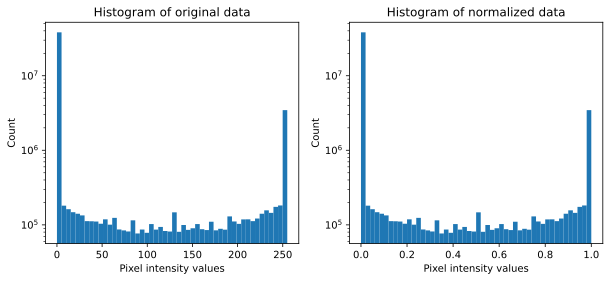

In [25]:
# normalize data to a range of [0, 1]
data_norm = data / np.max(data)

fig, ax = plt.subplots(1,2,figsize=(10,4))
ax[0].hist(data.flatten(), 50)
ax[0].set_xlabel('Pixel intensity values')
ax[0].set_ylabel('Count')
ax[0].set_title('Histogram of original data')
ax[0].set_yscale('log')

ax[1].hist(data_norm.flatten(), 50)
ax[1].set_xlabel('Pixel intensity values')
ax[1].set_ylabel('Count')
ax[1].set_title('Histogram of normalized data')
ax[1].set_yscale('log')

plt.show()

In [26]:
dataT = torch.tensor(data_norm).float()

In [34]:
def create_model():
    class MnistNet(nn.Module):
        def __init__(self):
            super().__init__()
            
            self.input = nn.Linear(784,150)
            
            self.enc = nn.Linear(150, 15)
            
            self.lat = nn.Linear(15, 150)
            
            self.dec = nn.Linear(150, 784)
            
            
        def forward(self, x):
            x = F.relu(self.input(x))
            code_x = F.relu(self.enc(x))
            x = F.relu(self.lat(code_x))
            
            y = torch.sigmoid(self.dec(x))
            
            return y, code_x
        
    model = MnistNet()
    
    loss_fun = nn.MSELoss()
    
    optimizer = torch.optim.Adam(model.parameters(), lr=.001)
    
    return model, loss_fun, optimizer

In [35]:
model, loss_fun, optimizer = create_model()

X = dataT[:5, :]
yHat = model(X)

print("Input shape:")
print(X.shape)
print(' ')

print(type(yHat), len(yHat))
print(' ')

print('Shape of model output:')
print(yHat[0].shape)
print(' ')

print('Shape of encoding layer output:')
print(yHat[1].shape)

Input shape:
torch.Size([5, 784])
 
<class 'tuple'> 2
 
Shape of model output:
torch.Size([5, 784])
 
Shape of encoding layer output:
torch.Size([5, 15])


In [36]:
num_of_epochs = 10000
def train_model():
    model, loss_func, optimizer = create_model()
    
    losses = torch.zeros(num_of_epochs)

    
    for epoch in range(num_of_epochs):
        
        randomidx = np.random.choice(dataT.shape[0], size=32)
        X = dataT[randomidx, :]
                
        yHat = model(X)[0]
        loss = loss_func(yHat, X)
            
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
            
        losses[epoch] = loss.item()
        
    return losses, model

Final loss: 0.0224


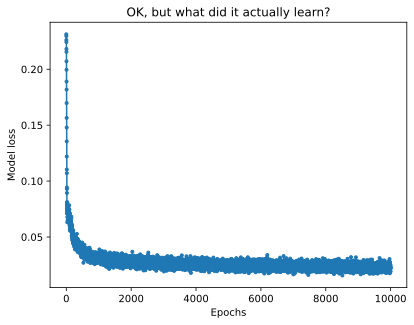

In [37]:
losses, model = train_model()

print(f"Final loss: {losses[-1]:.4f}")

plt.plot(losses, '.-')
plt.xlabel('Epochs')
plt.ylabel('Model loss')
plt.title('OK, but what did it actually learn?')
plt.show()

torch.Size([60000, 784])
torch.Size([60000, 15])


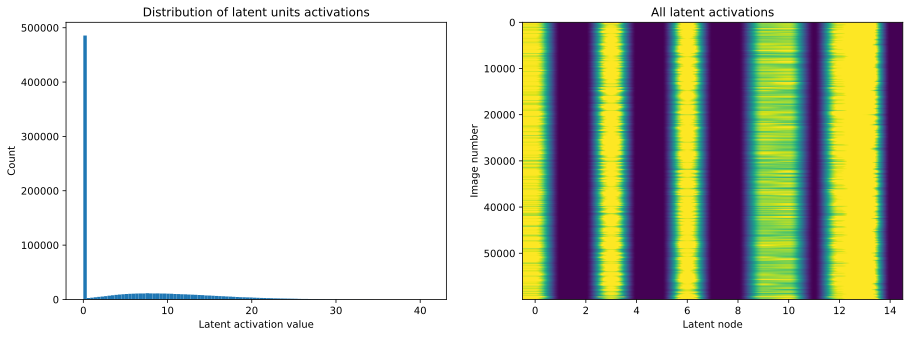

In [38]:
yHat, latent = model(dataT)

print(yHat.shape)
print(latent.shape)

fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].hist(latent.flatten().detach(),100)
ax[0].set_xlabel('Latent activation value')
ax[0].set_ylabel('Count')
ax[0].set_title('Distribution of latent units activations')

ax[1].imshow(latent.detach(), aspect='auto', vmin=0, vmax=10)
ax[1].set_xlabel('Latent node')
ax[1].set_ylabel('Image number')
ax[1].set_title('All latent activations')

plt.show()

/tmp/ipykernel_30907/181506396.py:5: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  source_code[:,i] = torch.mean(latent[digidx,:],axis=1).detach()


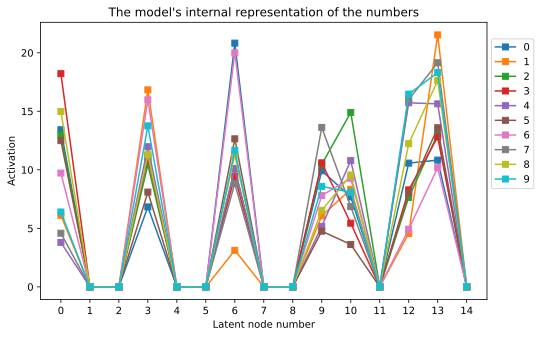

In [40]:
source_code = np.zeros((latent.shape[1],10))

for i in range(10):
    digidx = np.where(labels==i)
    source_code[:,i] = torch.mean(latent[digidx,:],axis=1).detach()
    
fig = plt.figure(figsize=(8,5))

plt.plot(source_code, 's-')
plt.legend(range(10),loc=(1.01, .4))
plt.xticks(range(15))
plt.xlabel('Latent node number')
plt.ylabel('Activation')
plt.title("The model's internal representation of the numbers")
plt.show()

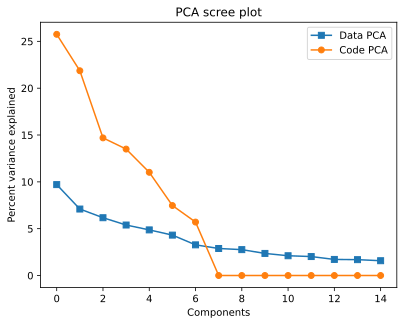

In [45]:
pca_data = PCA(n_components=15).fit(data)
pca_code = PCA().fit(latent.detach())

plt.plot(100*pca_data.explained_variance_ratio_, 's-', label='Data PCA')
plt.plot(100*pca_code.explained_variance_ratio_, 'o-', label='Code PCA')
plt.xlabel('Components')
plt.ylabel('Percent variance explained')
plt.title('PCA scree plot')
plt.legend()
plt.show()

In [48]:
scores_data = pca_data.fit_transform(data)
scores_code = pca_code.fit_transform(latent.detach())

fig, ax = plt.subplots(1,2,figsize=(15,5))

for lab in range(10):
    ax[0].plot(scores_data[labels==lab,0],scores_data[labels==lab,1],'o',markersize=3, alpha=.4)
    ax[1].plot(scores_code[labels==lab,0],scores_code[labels==lab,1],'o',markersize=3, alpha=.4)
    
for i in range(2):
    ax[i].set_xlabel('PC1 projection')
    ax[i].set_ylabel('PC2 projection')
    ax[i].legend(range(10))
    
ax[0].set_title('PCA of data')
ax[1].set_title('PCA of latent code')
plt.show()